

[PRESENTACION](https://www.canva.com/design/DAFhzk6-ztc/jMdo1CUxUrRKUhEWhMJo6w/view?utm_content=DAFhzk6-ztc&utm_campaign=designshare&utm_medium=link&utm_source=publishsharelink)



# Situación

La empresa de 15.000 colaboradores enfrenta 3.571 Renuncias anuales, lo que equivale a un Attrition del 23%


Fuente del Dataset:
https://www.kaggle.com/datasets/krismurphy01/data-lab?select=HR_Engagement_Sat_Sales_UpdatedV4.0.csv

# El problema

El costo por cada colaborador que renuncia equivale a  su sueldo anual.

Esto equivale a decir que podemos cuantificar nuestro problema estimandolo en:

3.571 Sueldos Anuales
23% Costo adicional pagado en estos sueldos.


[Artículo Josh Bersin](https://www.linkedin.com/pulse/20130816200159-131079-employee-retention-now-a-big-issue-why-the-tide-has-turned/)

# Objetivo

**El objetivo del presente trabajo es gestionar el Nivel de Renuncia, maximizando la inversión necesaria y los resultados esperados.**




# Propuestas:

**Propuesta A)**

    No hacer nada.

    Mantener el problema y sus costos asociados.


**Propuesta B)**

    Invertir mucho dinero en 15.000 colaboradores

    Invertir en todas las temáticas

    Seguramente pueda generar alguna mejora en el Attrition pero el costo sería muy alto.

**Propuesta C)**

    Proponemos:
    Accionar SOLO sobre una población mínima.
    Accionar SOLO sobre una temática por segmento.

**PROPONEMOS UNA INVERSION:**
*  **MÍNIMA**
*  **MUY PRECISA**
*  **Y CON ALTO IMPACTO SOBRE EL ATTRITION.**

# Proyecto

A FIN DE ACTUAR Y TOMAR MEDIDAS PARA ACCIONAR PARA EVITAR LAS RENUNCIAS NOS DISPONEMOS A:

*  Estudiar la información.
*  Predecir quién tiene mayor probabilidad de renunciar.
*  Identificar los factores o temáticas que más inciden en los niveles de renuncia o no renuncia.
*  Identificar las áreas o temáticas a trabajar.
*  Identificar la población sobre la cual trabajar.

# Diccionario de Datos


A continuación una descripción de los campos más relevantes del dataset:


    left_Company: Indica si el empleado renunció o no.

    Role: El puesto o título del empleado.

    EMP_Sat_OnPrem (N): Indicador de una encuesta que un tercero envió a los empleados, para situaciones presenciales.

    EMP_Sat_Remote(N): Indicador de una encuesta que un tercero envió a los empleados, para situaciones Home Office.

    number_project: El número de proyectos en los que trabaja el empleado a lo largo del año.

    time_spend_company: Años de servicio.

    salary: Grado salarial relativo (bajo, medio, alto).

    Emp_Identity: Grado de identificación del empleado con la empresa.

    Emp_Role: Cómo se identifica el empleado con la importancia de su rol en la empresa.

    Emp_Position: Cómo se identifica el empleado con la importancia de su puesto en la empresa.

    Emp_Title: Cómo se siente el empleado sobre su título.

    Sensor_StepCount: Los dispositivos sensibles se utilizan para capturar ciertas actividades de los empleados. En este caso número de pasos.

    average_montly_hours: El promedio de horas que trabaja el empleado.

    last_evaluation: La puntuación en la última evaluación del empleado.

    EMP_Engagement (N): Indicador de una encuesta que un tercero envió. Mide el compromiso y representa el sentimiento del empleado acerca de cómo se siente al participar en las actividades de la empresa

# Análisis Exploratorio

In [1]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

In [2]:
from google.colab import drive
import os
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [3]:
%cd '/content/gdrive/MyDrive/DS'
dsM = pd.read_csv('dataset_04.csv',sep=',') #Importo
dsM.dropna(subset=['Men_Leave'], inplace=True) #Me quedo con los Masculinos sin NaN

/content/gdrive/MyDrive/DS


In [4]:
%cd '/content/gdrive/MyDrive/DS'
dsF = pd.read_csv('dataset_04.csv',sep=',') #importo
dsF = dsF[(dsF.Gender == "F")] #Me quedo con los Femeninos, que están todos ok.

ds1 = pd.merge(dsM, dsF, how='outer') # Hago un merge para unir los Masculinos y los Femeninos en un dataset final.

/content/gdrive/MyDrive/DS


In [5]:
# Elimino los campos "Rissing Star" y "CSR Factor" dado que en la mayoria de los registros están vacíos.
ds1.drop('Rising_Star', axis= 1, inplace=True)
ds1.drop('CSR Factor', axis= 1, inplace=True)


In [6]:
# Remplazamos los vacios en Critical, considerando que si no estan identificados como critícos no lo son.
ds1['Critical'].fillna(0, inplace=True)

In [7]:
# Eliminamos los registros en los que 'EMP_Sat_OnPrem_1' está vacío.
ds1.dropna(subset=['EMP_Sat_OnPrem_1'], inplace=True)

In [8]:
# Revisamos las estadísticas de los registros.
ds1.describe()

,ID,Will_Relocate,Critical,Trending Perf,Talent_Level,Validated_Talent_Level,Percent_Remote,EMP_Sat_OnPrem_1,EMP_Sat_OnPrem_2,EMP_Sat_OnPrem_3,...,Emp_Competitive_4,Emp_Competitive_5,Emp_Collaborative_1,Emp_Collaborative_2,Emp_Collaborative_3,Emp_Collaborative_4,Emp_Collaborative_5,Sensor_StepCount,Sensor_Heartbeat(Average/Min),Sensor_Proximity(1-highest/10-lowest)
count,12355.000000,12355.000000,12355.000000,12355.0,12355.0,12355.0,12355.000000,12355.0,12355.000000,12355.000000,...,12355.000000,12355.000000,12355.000000,12355.00000,12355.000000,12355.000000,12355.000000,12355.000000,12355.000000,12355.000000
mean,6809.119790,0.499636,0.038527,3.0,6.0,6.0,0.580121,3.0,2.680777,3.680777,...,3.008256,2.983084,2.976932,1.64824,3.005989,2.999191,3.017078,3103.687171,78.242979,6.690409
std,4306.687772,0.500020,0.192472,0.0,0.0,0.0,0.192177,0.0,0.732520,0.732520,...,1.408282,1.413168,1.413653,0.82504,1.409672,1.409340,1.411790,1744.792249,7.784133,2.501429
min,1.000000,0.000000,0.000000,3.0,6.0,6.0,0.400000,3.0,1.000000,2.000000,...,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1000.000000,60.000000,1.000000
25%,3110.500000,0.000000,0.000000,3.0,6.0,6.0,0.400000,3.0,3.000000,4.000000,...,2.000000,2.000000,2.000000,1.00000,2.000000,2.000000,2.000000,1597.000000,74.000000,6.000000
50%,6236.000000,0.000000,0.000000,3.0,6.0,6.0,0.500000,3.0,3.000000,4.000000,...,3.000000,3.000000,3.000000,2.00000,3.000000,3.000000,3.000000,2604.000000,78.000000,7.000000
75%,10557.500000,1.000000,0.000000,3.0,6.0,6.0,0.800000,3.0,3.000000,4.000000,...,4.000000,4.000000,4.000000,2.00000,4.000000,4.000000,4.000000,4509.000000,86.000000,9.000000
max,14868.000000,1.000000,1.000000,3.0,6.0,6.0,0.800000,3.0,3.000000,4.000000,...,5.000000,5.000000,5.000000,5.00000,5.000000,5.000000,5.000000,8500.000000,90.000000,10.000000


In [9]:
# Generamos el campo Emp_engag_Prom para que contenga un promedio de las 5 encuentas de Engagment
ds1['EMP_Engag_Prom'] = ds1[['EMP_Engagement_1','EMP_Engagement_2','EMP_Engagement_3','EMP_Engagement_4','EMP_Engagement_5']].mean(axis=1)

In [10]:
# Generamos el campo EMP_Sat_On_P para que contenga un promedio de las 5 encuentas de Satisfaccion Presenciales
ds1['EMP_Sat_On_P'] = ds1[['EMP_Sat_OnPrem_1','EMP_Sat_OnPrem_2','EMP_Sat_OnPrem_3','EMP_Sat_OnPrem_4','EMP_Sat_OnPrem_5']].mean(axis=1)

In [11]:
# Generamos el campo EMP_Sat_On_P para que contenga un promedio de las 5 encuentas de Satisfaccion Remotos
ds1['EMP_Sat_Rem_P'] = ds1[['EMP_Sat_Remote_1','EMP_Sat_Remote_2','EMP_Sat_Remote_3','EMP_Sat_Remote_4','EMP_Sat_Remote_5']].mean(axis=1)

In [12]:
# Generamos el campo EMP_Sat_On_P para que contenga un promedio de Emp_Collaborative
ds1['Emp_Collaborative'] = ds1[['Emp_Collaborative_1','Emp_Collaborative_2','Emp_Collaborative_3','Emp_Collaborative_4','Emp_Collaborative_5']].mean(axis=1)

In [13]:
# Generamos el campo EMP_Sat_On_P para que contenga un promedio de Emp_Competitive
ds1['Emp_Competitive'] = ds1[['Emp_Competitive_1','Emp_Competitive_2','Emp_Competitive_3','Emp_Competitive_4','Emp_Competitive_5']].mean(axis=1)

In [14]:
# Eliminamos columnas no relevantes
ds1.drop(['Trending Perf','Talent_Level','Validated_Talent_Level'], axis=1, inplace=True)

In [15]:
# Revisamos las estadísticas de los campos mas relevantes
ds1.describe()

,ID,Will_Relocate,Critical,Percent_Remote,EMP_Sat_OnPrem_1,EMP_Sat_OnPrem_2,EMP_Sat_OnPrem_3,EMP_Sat_OnPrem_4,EMP_Sat_OnPrem_5,EMP_Sat_Remote_1,...,Emp_Collaborative_4,Emp_Collaborative_5,Sensor_StepCount,Sensor_Heartbeat(Average/Min),Sensor_Proximity(1-highest/10-lowest),EMP_Engag_Prom,EMP_Sat_On_P,EMP_Sat_Rem_P,Emp_Collaborative,Emp_Competitive
count,12355.000000,12355.000000,12355.000000,12355.000000,12355.0,12355.000000,12355.000000,12355.000000,12355.000000,12355.000000,...,12355.000000,12355.000000,12355.000000,12355.000000,12355.000000,12355.000000,12355.000000,12355.000000,12355.000000,12355.000000
mean,6809.119790,0.499636,0.038527,0.580121,3.0,2.680777,3.680777,2.680777,3.933549,2.741724,...,2.999191,3.017078,3103.687171,78.242979,6.690409,3.521473,3.195176,3.539814,2.729486,2.587034
std,4306.687772,0.500020,0.192472,0.192177,0.0,0.732520,0.732520,0.732520,1.358168,0.746848,...,1.409340,1.411790,1744.792249,7.784133,2.501429,1.080815,0.701230,0.897919,0.585033,0.600316
min,1.000000,0.000000,0.000000,0.400000,3.0,1.000000,2.000000,1.000000,1.000000,2.000000,...,1.000000,1.000000,1000.000000,60.000000,1.000000,1.800000,1.600000,2.400000,1.000000,1.000000
25%,3110.500000,0.000000,0.000000,0.400000,3.0,3.000000,4.000000,3.000000,4.000000,2.000000,...,2.000000,2.000000,1597.000000,74.000000,6.000000,1.800000,3.400000,2.400000,2.400000,2.200000
50%,6236.000000,0.000000,0.000000,0.500000,3.0,3.000000,4.000000,3.000000,4.000000,3.000000,...,3.000000,3.000000,2604.000000,78.000000,7.000000,4.200000,3.400000,4.200000,2.800000,2.600000
75%,10557.500000,1.000000,0.000000,0.800000,3.0,3.000000,4.000000,3.000000,5.000000,3.000000,...,4.000000,4.000000,4509.000000,86.000000,9.000000,4.200000,3.600000,4.200000,3.200000,3.000000
max,14868.000000,1.000000,1.000000,0.800000,3.0,3.000000,4.000000,3.000000,5.000000,5.000000,...,5.000000,5.000000,8500.000000,90.000000,10.000000,4.200000,3.600000,4.600000,5.000000,4.800000


In [16]:
ds1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12355 entries, 0 to 12402
Data columns (total 62 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   ID                                     12355 non-null  int64  
 1   Name                                   12353 non-null  object 
 2   Department                             12355 non-null  object 
 3   GEO                                    12355 non-null  object 
 4   Role                                   12355 non-null  object 
 5   Will_Relocate                          12355 non-null  int64  
 6   Critical                               12355 non-null  float64
 7   Percent_Remote                         12355 non-null  float64
 8   EMP_Sat_OnPrem_1                       12355 non-null  float64
 9   EMP_Sat_OnPrem_2                       12355 non-null  float64
 10  EMP_Sat_OnPrem_3                       12355 non-null  float64
 11  EM

Text(0.5, 1.0, 'Dispersión de Cantidad de Proyectos al año')

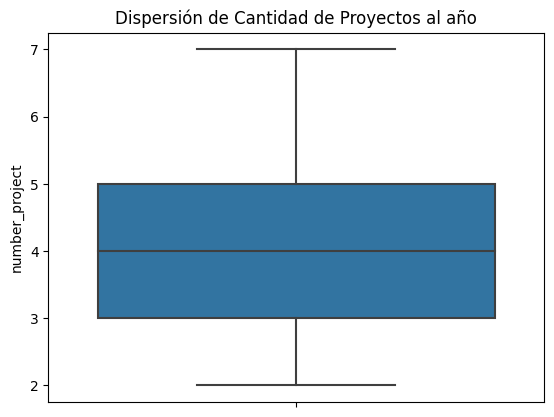

In [17]:
# Axis-level
ax = sns.boxplot(y="number_project", data=ds1)
plt.title('Dispersión de Cantidad de Proyectos al año')


Encontramos una dispersión en la población evaluada respecto a la cantidad anual de proyectos en lo que trabajan los colaboradores.

Text(0.5, 1.0, 'Renuncias segun Cantidad de Proyectos')

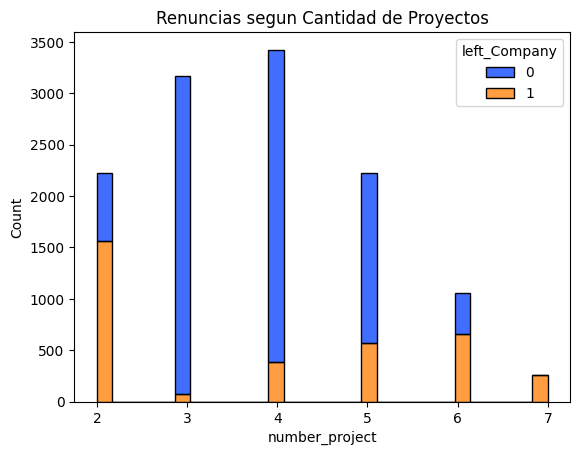

In [18]:
sns.histplot(data=ds1, x="number_project", hue="left_Company", multiple="stack", palette='bright')
plt.title('Renuncias segun Cantidad de Proyectos')

Al revisar los niveles de renuncia encontramos distintos comportamientos, entre los que se destacan que:

*   Con mas de 3 proyectos anuales, incrementa el % de renuncias conforme incrementan la cantidad de proyectos.

*   Con 7 proyectos el 100% termina renunciando.

*   Con sólo 2 proyectos anuales los niveles de renuncia son del 42%.





Text(0.5, 1.0, 'Renuncias segun la última evaluación')

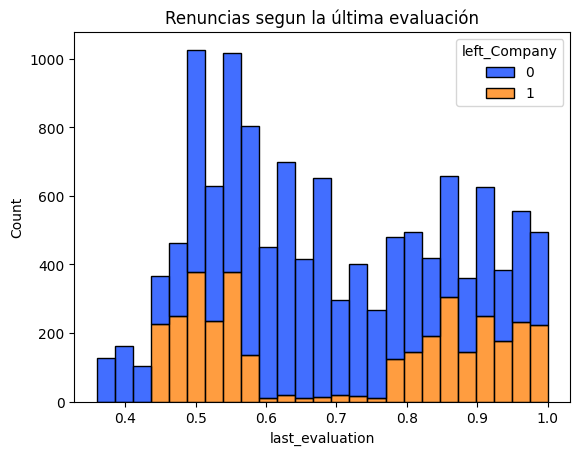

In [19]:
sns.histplot(data=ds1, x="last_evaluation", hue="left_Company", multiple="stack", palette='bright')
plt.title('Renuncias segun la última evaluación')

Revisamos la cantiad de renuncias frente a los resultados de la ultima evaluacion; encontramos dos grupos de renunciantes uno en quienes obtuvieron un resultado medio/bajo y un segundo grupo entre quienes recibieron las mejores evaluaciones.

Text(0.5, 1.0, 'Renuncias segun el promedio de horas mensuales')

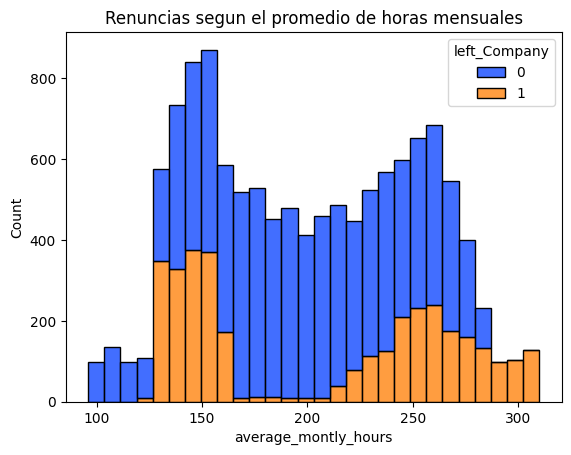

In [20]:

sns.histplot(data=ds1, x="average_montly_hours", hue="left_Company", multiple="stack", palette='bright')
plt.title('Renuncias segun el promedio de horas mensuales')

Revisamos las renuncias frente a la cantidad de horas mensuales trabajadas, y encontramos dos grupos de renunciantes, uno agrupado entre quienes trabajan entre 120 y 160 horas y otro grupo de renunciantes entre quienes trabaja mas de 240 horas.

Text(0.5, 1.0, 'Renuncias segun años en la compañia')

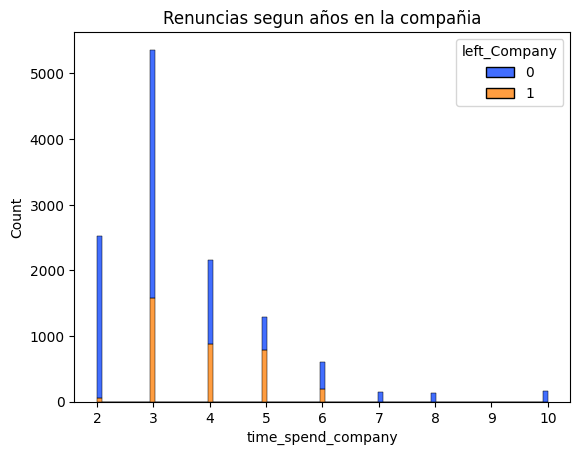

In [21]:
sns.histplot(data=ds1, x="time_spend_company", hue="left_Company", multiple="stack", palette='bright')
plt.title('Renuncias segun años en la compañia')

Revisamos la cantidad de renuncias en funció a la antigüedad en la compaña, y vemos que la mayoría de los renunciantes tiene entre 3 y 5 años de antiguedad, estando concentrgados en el tercer año.

Text(0.5, 1.0, 'Renuncias segun Accidentes de trabajo')

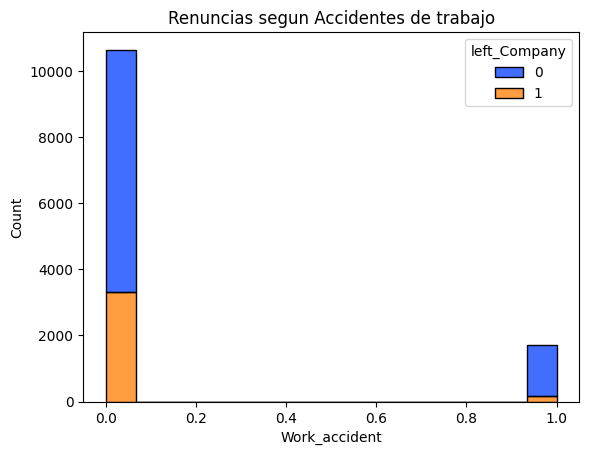

In [22]:
sns.histplot(data=ds1, x="Work_accident", hue="left_Company", multiple="stack", palette='bright')
plt.title('Renuncias segun Accidentes de trabajo')

Revisamos la renuncias en función de quienes tuvieron o no tuvieron accidentes de trabajo, y vemos que haber sufrido un accidente no es determinante para renunciar.

Text(0.5, 1.0, 'Renuncias segun Promcociones en los últimos años')

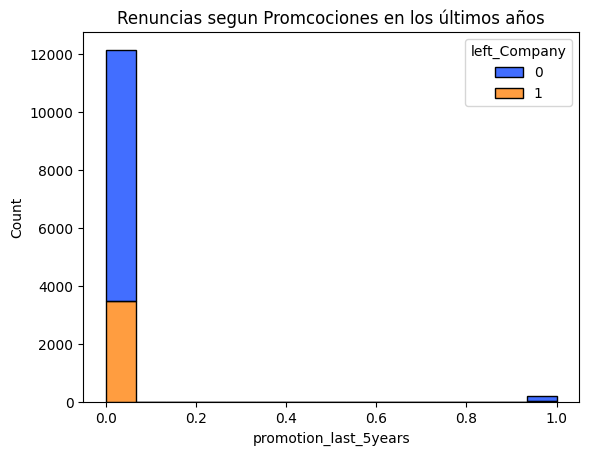

In [23]:
sns.histplot(data=ds1, x="promotion_last_5years", hue="left_Company", multiple="stack", palette='bright')
plt.title('Renuncias segun Promcociones en los últimos años')

Analizamos las renuncias frente a quienes recibieron una promoción en los últimos 5 años, y vemos que ninguno de los renunciantes fue promovido en los útlimos 5 años.

In [24]:
# Generamos un dataset solo con los que renunciarton
ds2 = ds1[(ds1.left_Company == 1)]

Text(0.5, 1.0, 'Renuncias segun Nivel Salarial')

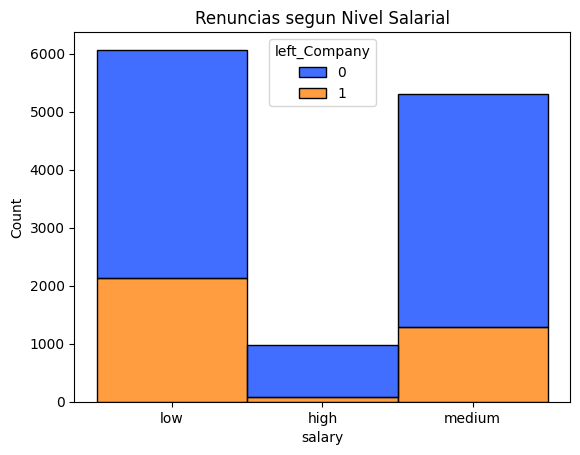

In [25]:
sns.histplot(data=ds1, x="salary", hue="left_Company", multiple="stack", palette='bright')
plt.title('Renuncias segun Nivel Salarial')

Revisamos las renuncias según nivel salarial y vemos una menor predisposición a renunciar en los casos de altos salarios.

Los colaboradores de alto salario son los que menos renuncian

Text(0.5, 1.0, 'Renuncias segun Indentidad con la empresa')

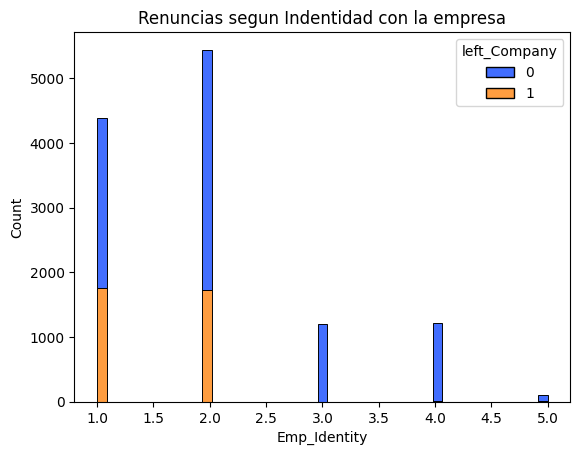

In [26]:
sns.histplot(data=ds1, x="Emp_Identity", hue="left_Company", multiple="stack", palette='bright')
plt.title('Renuncias segun Indentidad con la empresa')

Todos los renunciantes tenian una baja identificacion con la compañía

Text(0.5, 1.0, 'Renuncia de Recursos Críticos')

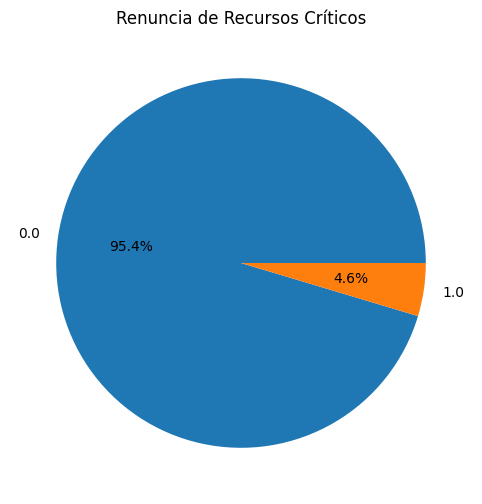

In [27]:
ds2D=ds2[['ID', 'Critical']].groupby(by='Critical').count()
ds2D
fig,ax = plt.subplots(figsize =(10, 6))
ax.pie(ds2D.ID, labels = ds2D.index,autopct='%1.1f%%')
ax.set_title('Renuncia de Recursos Críticos')

El 95.4 % de los colaboradores que renuncias no son Críticos.

Text(0.5, 1.0, 'Renunciados promotion_last_5years')

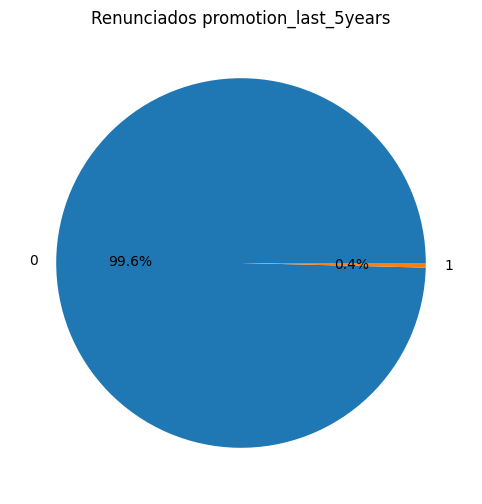

In [28]:
ds2D=ds2[['ID', 'promotion_last_5years']].groupby(by='promotion_last_5years').count()
ds2D
fig,ax = plt.subplots(figsize =(10, 6))
ax.pie(ds2D.ID, labels = ds2D.index,autopct='%1.1f%%')
ax.set_title('Renunciados promotion_last_5years')

Mas del 99% de los renunciantes no obtuvo promociones en los ultimos 5 años

Text(0.5, 1.0, 'Renuncias según Nivel de Engagement 1')

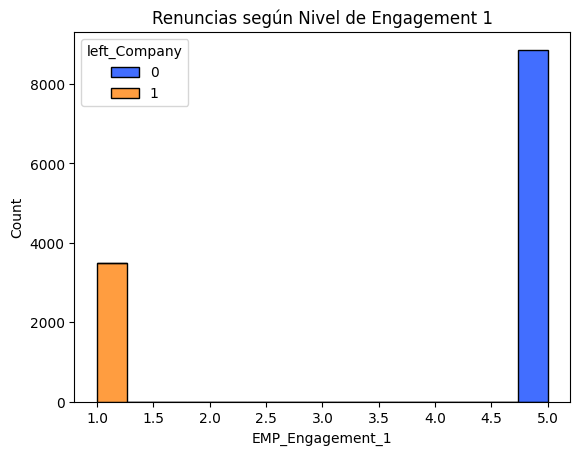

In [29]:
sns.histplot(data=ds1, x="EMP_Engagement_1", hue="left_Company", multiple="stack", palette='bright')
plt.title('Renuncias según Nivel de Engagement 1')

Las encuestas de Engagement aportan una valoración del compromiso de los colaboradores.

Analizando la relacion entre los resultados de Encuesta de Engagement y las renuncias, encontramos que el 100% de los colaboradores con bajo Engagement renunciaron.

Mientas que el 100% de los colaboradores que con altos niveles de Engagement en las encuestas no renunciaron.


Text(0.5, 1.0, 'Renuncias según nivel de Engagement PROMEDIO')

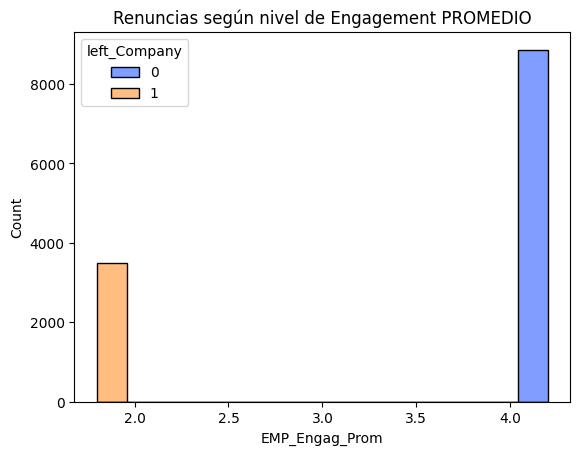

In [30]:
sns.histplot(data=ds1, x="EMP_Engag_Prom", hue="left_Company",  palette='bright')
plt.title('Renuncias según nivel de Engagement PROMEDIO')

Calculamos el promedio de las 5 encuestas de Engagemente de las que se cuenta con información, y se mantiene la relación: con bajo nivel de Engagement el 100% de los colaboradores renuncia, mientras que el 100% de los colaboradores con alto Engagement o conmpromiso no renuncia.

In [31]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
  Preparing metadata (setup.py) ... done


In [32]:
import pandas_profiling

<ipython-input-32-6a00893fb3e1>:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  import pandas_profiling


In [33]:
import ydata_profiling

In [34]:
from pandas_profiling import ProfileReport

In [35]:
! pip install --upgrade pip
! pip install --upgrade Pillow

In [36]:
#Data Profiling
profile = pandas_profiling.ProfileReport(ds1)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [37]:
#Principales medidas estadisticas
ds1.describe().T

,count,mean,std,min,25%,50%,75%,max
ID,12355.0,6809.119790,4306.687772,1.00,3110.50,6236.00,10557.50,14868.0
Will_Relocate,12355.0,0.499636,0.500020,0.00,0.00,0.00,1.00,1.0
Critical,12355.0,0.038527,0.192472,0.00,0.00,0.00,0.00,1.0
Percent_Remote,12355.0,0.580121,0.192177,0.40,0.40,0.50,0.80,0.8
EMP_Sat_OnPrem_1,12355.0,3.000000,0.000000,3.00,3.00,3.00,3.00,3.0
EMP_Sat_OnPrem_2,12355.0,2.680777,0.732520,1.00,3.00,3.00,3.00,3.0
EMP_Sat_OnPrem_3,12355.0,3.680777,0.732520,2.00,4.00,4.00,4.00,4.0
EMP_Sat_OnPrem_4,12355.0,2.680777,0.732520,1.00,3.00,3.00,3.00,3.0
EMP_Sat_OnPrem_5,12355.0,3.933549,1.358168,1.00,4.00,4.00,5.00,5.0
EMP_Sat_Remote_1,12355.0,2.741724,0.746848,2.00,2.00,3.00,3.00,5.0


# Primeros insight

Podemos construir el Perfil del Renunciante con las siguientes caracteríticas:

*  No fue promovido en los últimos 5 años!
*  No se indentifica con la Compañia.
*  No es un Recurso Crítico!
*  No está comprometico con la Compañia.


# Recomendaciones


*  Diseñar acciones de retención con un costo inferior al sueldo anual del colaborador, con foco en esos colaboradores.

*  Estaremos generando una GANANCIA.

*  Estaremos traccionando ademas otros indicadores de la compañía

# Arbol de decisión

In [38]:
ds1_num = ds1.select_dtypes('number') #Descartamos variables que no son suméricas, y que previamente se consideraron poco relavantes.
ds1_num.head()

,ID,Will_Relocate,Critical,Percent_Remote,EMP_Sat_OnPrem_1,EMP_Sat_OnPrem_2,EMP_Sat_OnPrem_3,EMP_Sat_OnPrem_4,EMP_Sat_OnPrem_5,EMP_Sat_Remote_1,...,Emp_Collaborative_4,Emp_Collaborative_5,Sensor_StepCount,Sensor_Heartbeat(Average/Min),Sensor_Proximity(1-highest/10-lowest),EMP_Engag_Prom,EMP_Sat_On_P,EMP_Sat_Rem_P,Emp_Collaborative,Emp_Competitive
0,1,0,1.0,0.4,3.0,3.0,4.0,3.0,5.0,2,...,1,5,1841,61,9,4.2,3.6,2.4,2.4,2.4
1,4,0,0.0,0.4,3.0,3.0,4.0,3.0,5.0,2,...,4,1,3248,77,6,4.2,3.6,2.4,2.4,2.0
2,9,0,0.0,0.4,3.0,3.0,4.0,3.0,5.0,2,...,3,2,1974,64,7,4.2,3.6,2.4,3.0,2.8
3,11,0,1.0,0.4,3.0,3.0,4.0,3.0,5.0,2,...,5,4,2121,80,10,4.2,3.6,2.4,3.2,2.8
4,13,0,1.0,0.4,3.0,3.0,4.0,3.0,5.0,2,...,5,2,3056,76,9,4.2,3.6,2.4,2.8,2.8


In [39]:
ds1_num.dropna(axis=1, inplace=True) #Descartamos variables con valores NaN.

In [40]:
#ds1_num = ds1_num.drop('ID', axis=1) #Descartamos campo de identación.

In [41]:
# Generamos features y target
X = ds1_num.drop('left_Company', axis=1)
y = ds1_num['left_Company']

In [42]:
from sklearn.model_selection import train_test_split
# Train test split
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2,
                                                    random_state=0,
                                                    stratify= y)


print('Tamaño del set de Entrenamiento:', X_train.shape)
print('Tamaño del set de Testeo:', X_test.shape)

Tamaño del set de Entrenamiento: (9884, 52)
Tamaño del set de Testeo: (2471, 52)


In [43]:
100*y_train.sum()/len(y_train) # Porcentaje de True en train

28.267907729664103

In [44]:
100*y_test.sum()/len(y_test) # Porcentaje de True en test

28.2881424524484

In [45]:
from sklearn.tree import DecisionTreeClassifier # Modelo

In [46]:
# Instanciar el objeto/modelo
tree_model = DecisionTreeClassifier(random_state = 0, class_weight='balanced')

In [47]:
# Ajustar el modelo con los datos
tree_model.fit(X_train, y_train)

DecisionTreeClassifier(class_weight='balanced', random_state=0)

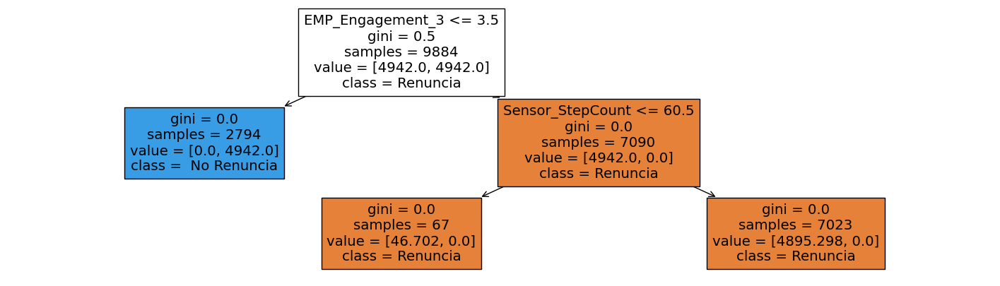

In [48]:
# Graficamos el Arbol
from sklearn import tree
fig = plt.figure(figsize=(18,5))
_ = tree.plot_tree(tree_model,feature_names = list(ds1_num),class_names=['Renuncia',' No Renuncia'],
                   filled=True)

In [49]:
# predicciones
y_pred = tree_model.predict(X_test)
y_pred_train = tree_model.predict(X_train)

In [50]:
X_test.shape, y_test.shape

((2471, 52), (2471,))

In [51]:
y_pred.shape

(2471,)

In [52]:
X_test

,ID,Will_Relocate,Critical,Percent_Remote,EMP_Sat_OnPrem_1,EMP_Sat_OnPrem_2,EMP_Sat_OnPrem_3,EMP_Sat_OnPrem_4,EMP_Sat_OnPrem_5,EMP_Sat_Remote_1,...,Emp_Collaborative_4,Emp_Collaborative_5,Sensor_StepCount,Sensor_Heartbeat(Average/Min),Sensor_Proximity(1-highest/10-lowest),EMP_Engag_Prom,EMP_Sat_On_P,EMP_Sat_Rem_P,Emp_Collaborative,Emp_Competitive
684,1434,0,0.0,0.4,3.0,3.0,4.0,3.0,5.0,2,...,5,1,2294,76,7,4.2,3.6,2.4,2.6,2.6
9055,8284,0,0.0,0.8,3.0,3.0,4.0,3.0,4.0,3,...,3,5,5466,79,8,4.2,3.4,4.2,3.4,3.2
1938,4051,1,0.0,0.4,3.0,3.0,4.0,3.0,5.0,2,...,3,1,2042,90,9,4.2,3.6,2.4,1.8,3.0
431,907,0,0.0,0.4,3.0,3.0,4.0,3.0,5.0,2,...,4,5,1844,67,8,1.8,3.6,2.4,3.2,3.0
7516,5187,0,0.0,0.4,3.0,1.0,2.0,1.0,1.0,3,...,5,2,1361,89,9,4.2,1.6,4.2,2.6,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10785,11680,1,0.0,0.8,3.0,3.0,4.0,3.0,4.0,3,...,4,2,5691,73,3,4.2,3.4,4.2,3.6,3.0
2574,5368,1,0.0,0.4,3.0,1.0,2.0,1.0,1.0,3,...,5,5,1429,87,10,4.2,1.6,4.2,3.2,2.6
8407,6935,0,0.0,0.5,3.0,1.0,2.0,1.0,1.0,3,...,1,4,1008,89,6,4.2,1.6,4.2,2.4,3.0
9331,8792,0,0.0,0.8,3.0,3.0,4.0,3.0,4.0,3,...,3,2,5718,80,9,4.2,3.4,4.2,2.4,3.2


In [53]:
y_pred[:10]

array([0, 0, 0, 1, 0, 1, 0, 0, 0, 0])

In [54]:
y_test[:10].values

array([0, 0, 0, 1, 0, 1, 0, 0, 0, 0])

In [55]:
# Evaluacion
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

In [56]:
# Evaluamos el modelo en el conjunto de entrenamiento:
recall = recall_score(y_train, y_pred_train)
precision = precision_score(y_train, y_pred_train)
acc = accuracy_score(y_train, y_pred_train)
f1 = f1_score(y_train, y_pred_train)

print('METRICAS TRAIN:')
print('Recall: {:.4f}'.format(recall))
print('Precision: {:.4f}'.format(precision))
print('F1: {:.4f}'.format(f1))
print('Accuracy: {:.4f}'.format(acc))

METRICAS TRAIN:
Recall: 1.0000
Precision: 1.0000
F1: 1.0000
Accuracy: 1.0000


In [57]:
# Evaluamos el modelo ya entrenado en el conjunto de testeo
recall = recall_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
acc = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

print('METRICAS TEST:')
print('Recall: {:.4f}'.format(recall))
print('Precision: {:.4f}'.format(precision))
print('F1: {:.4f}'.format(f1))
print('Accuracy: {:.4f}'.format(acc))

METRICAS TEST:
Recall: 1.0000
Precision: 1.0000
F1: 1.0000
Accuracy: 1.0000


In [58]:
confusion_matrix(y_test, y_pred)

array([[1772,    0],
       [   0,  699]])

In [59]:
y_test.value_counts()

0    1772
1     699
Name: left_Company, dtype: int64

In [60]:
type(y_pred)

numpy.ndarray

In [61]:
pd.Series(y_pred).value_counts()

0    1772
1     699
dtype: int64

In [62]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1772
           1       1.00      1.00      1.00       699

    accuracy                           1.00      2471
   macro avg       1.00      1.00      1.00      2471
weighted avg       1.00      1.00      1.00      2471



In [63]:
proba = tree_model.predict_proba(X_test)
proba

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       ...,
       [1., 0.],
       [1., 0.],
       [1., 0.]])

In [64]:
tree_model.feature_importances_

array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       1.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 5.64215341e-13, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00])

In [65]:
df_importancia = pd.DataFrame({'Variable': X_train.columns.values.tolist(),
                               'Importancia': tree_model.feature_importances_}).sort_values(by='Importancia', ascending=False)

df_importancia

,Variable,Importancia
16,EMP_Engagement_3,1.000000e+00
45,Sensor_Heartbeat(Average/Min),5.642153e-13
0,ID,0.000000e+00
38,Emp_Competitive_5,0.000000e+00
29,Emp_Work_Status_5,0.000000e+00
30,Emp_Identity,0.000000e+00
31,Emp_Role,0.000000e+00
32,Emp_Position,0.000000e+00
33,Emp_Title,0.000000e+00
34,Emp_Competitive_1,0.000000e+00


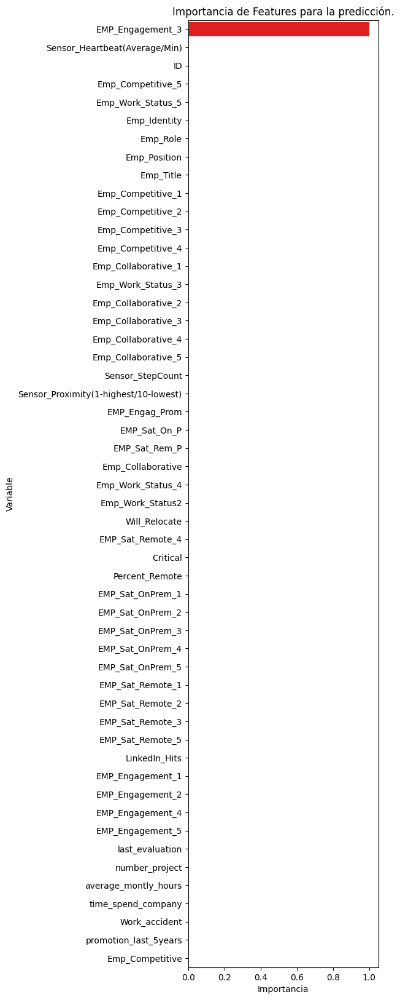

In [66]:
plt.figure(figsize=(4,20))

values = df_importancia.Importancia

sns.barplot(y=df_importancia.Variable,
            x=values,
            palette = ['green' if (x < max(values)) else 'red' for x in values ]
           ).set(title='Importancia de Features para la predicción.')

plt.show()

El Emp_Engagement 3 que es una encuesta de compromiso es la variable de mayor importancia para evaluar la probabilidad de renuncia de un colaborador.

Los valores Recall, Precision, F1 y Accuracy no parecen corresponder con datos reales, esto está aclarado por la fuente del dataset.





# Perfil Renunciante


Habiendo identificado al Engagement como variable que correlaciona directamente con las renuncias, encaramos el siguiente paso: delinear el perfil del renunciante.
Debido a ello analizaremos las variables que más correlacionan con el Engagement, para así analizar en que temas se puede trabajar para generar cambios.

## Clustering

In [67]:
# K-Means Clustering
from sklearn.cluster import KMeans
# Importacion de librerias
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

In [68]:
ds1_num.describe().T

,count,mean,std,min,25%,50%,75%,max
ID,12355.0,6809.119790,4306.687772,1.00,3110.50,6236.00,10557.50,14868.0
Will_Relocate,12355.0,0.499636,0.500020,0.00,0.00,0.00,1.00,1.0
Critical,12355.0,0.038527,0.192472,0.00,0.00,0.00,0.00,1.0
Percent_Remote,12355.0,0.580121,0.192177,0.40,0.40,0.50,0.80,0.8
EMP_Sat_OnPrem_1,12355.0,3.000000,0.000000,3.00,3.00,3.00,3.00,3.0
EMP_Sat_OnPrem_2,12355.0,2.680777,0.732520,1.00,3.00,3.00,3.00,3.0
EMP_Sat_OnPrem_3,12355.0,3.680777,0.732520,2.00,4.00,4.00,4.00,4.0
EMP_Sat_OnPrem_4,12355.0,2.680777,0.732520,1.00,3.00,3.00,3.00,3.0
EMP_Sat_OnPrem_5,12355.0,3.933549,1.358168,1.00,4.00,4.00,5.00,5.0
EMP_Sat_Remote_1,12355.0,2.741724,0.746848,2.00,2.00,3.00,3.00,5.0


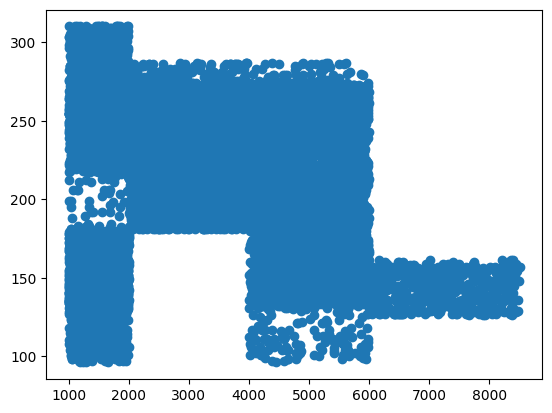

In [69]:
plt.scatter(ds1_num['Sensor_StepCount'], ds1_num['average_montly_hours'])

Aqui vemos la distribución de los colaboradores segmentándolos por la cantidad de horas promedio y la cantidad de pasos según sensor; encontramos distintos patrones de comportamiento.

In [70]:
#Generamos nuestra x
X = ds1_num.iloc[:, [45, 21]].values

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

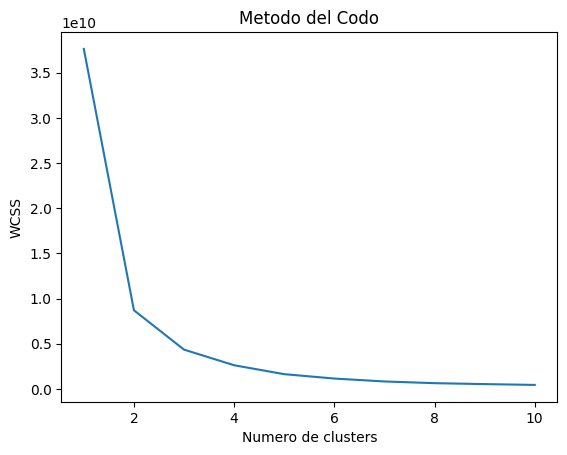

[37641401336.15326, 8707144085.490719, 4347379122.404833, 2619569749.7424307, 1631192392.297175, 1146237511.3846571, 823587843.7854733, 634871757.625561, 532383573.1956508, 440625021.70576125]


In [71]:
# Metodo del Codo para encontrar el numero optimo de clusters
from sklearn.cluster import KMeans
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 0)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)


# Grafica de la suma de las distancias
plt.plot(range(1, 11), wcss)
plt.title('Metodo del Codo')
plt.xlabel('Numero de clusters')
plt.ylabel('WCSS')
plt.show()

print(wcss)

Graficamos para determinar la cantida óptime de clusteres.

In [72]:
y_kmeans = kmeans.labels_

In [73]:
y_kmeans

array([1, 3, 1, ..., 4, 0, 4], dtype=int32)

In [74]:
ds1_num['pred']=y_kmeans
ds1_num.head().T

,0,1,2,3,4
ID,1.00,4.00,9.00,11.00,13.00
Will_Relocate,0.00,0.00,0.00,0.00,0.00
Critical,1.00,0.00,0.00,1.00,1.00
Percent_Remote,0.40,0.40,0.40,0.40,0.40
EMP_Sat_OnPrem_1,3.00,3.00,3.00,3.00,3.00
EMP_Sat_OnPrem_2,3.00,3.00,3.00,3.00,3.00
EMP_Sat_OnPrem_3,4.00,4.00,4.00,4.00,4.00
EMP_Sat_OnPrem_4,3.00,3.00,3.00,3.00,3.00
EMP_Sat_OnPrem_5,5.00,5.00,5.00,5.00,5.00
EMP_Sat_Remote_1,2.00,2.00,2.00,2.00,2.00


In [75]:
ds1_num.groupby(['pred']).mean()
ds1_num.describe().T

,count,mean,std,min,25%,50%,75%,max
ID,12355.0,6809.119790,4306.687772,1.00,3110.50,6236.00,10557.50,14868.0
Will_Relocate,12355.0,0.499636,0.500020,0.00,0.00,0.00,1.00,1.0
Critical,12355.0,0.038527,0.192472,0.00,0.00,0.00,0.00,1.0
Percent_Remote,12355.0,0.580121,0.192177,0.40,0.40,0.50,0.80,0.8
EMP_Sat_OnPrem_1,12355.0,3.000000,0.000000,3.00,3.00,3.00,3.00,3.0
EMP_Sat_OnPrem_2,12355.0,2.680777,0.732520,1.00,3.00,3.00,3.00,3.0
EMP_Sat_OnPrem_3,12355.0,3.680777,0.732520,2.00,4.00,4.00,4.00,4.0
EMP_Sat_OnPrem_4,12355.0,2.680777,0.732520,1.00,3.00,3.00,3.00,3.0
EMP_Sat_OnPrem_5,12355.0,3.933549,1.358168,1.00,4.00,4.00,5.00,5.0
EMP_Sat_Remote_1,12355.0,2.741724,0.746848,2.00,2.00,3.00,3.00,5.0


In [76]:
kmeans.cluster_centers_[:,0], kmeans.cluster_centers_[:, 1]

(array([4370.22869565, 1783.20580573, 6792.11344538, 3113.07931727,
        5699.12205754, 1262.3003663 , 2457.05608365, 3736.23014257,
        5025.3380158 , 7910.4017094 ]),
 array([201.80869565, 191.7722367 , 143.58403361, 228.48493976,
        196.85353095, 188.17179487, 228.27471483, 224.8910387 ,
        203.85864794, 142.60683761]))

In [77]:
# Creando el k-Means para los 4 grupos encontrados
kmeans = KMeans(n_clusters = 4, init = 'k-means++', random_state = 0) #k-means++ acelera la convergencia, respecto de random
y_kmeans = kmeans.fit_predict(X)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


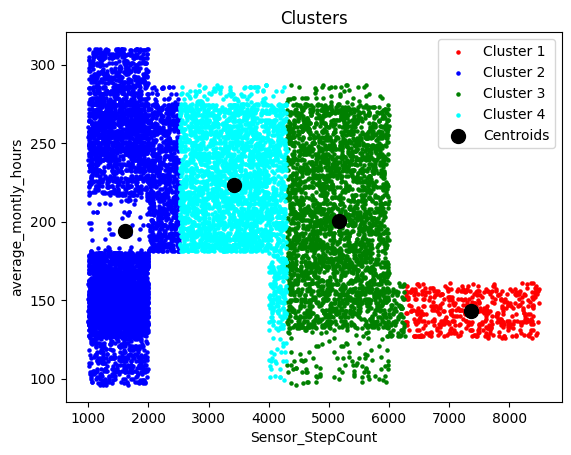

In [78]:
# Visualizacion grafica de los clusters
plt.scatter(X[y_kmeans == 0, 0], X[y_kmeans == 0, 1], s = 5, c = 'red', label = 'Cluster 1')
plt.scatter(X[y_kmeans == 1, 0], X[y_kmeans == 1, 1], s = 5, c = 'blue', label = 'Cluster 2')
plt.scatter(X[y_kmeans == 2, 0], X[y_kmeans == 2, 1], s = 5, c = 'green', label = 'Cluster 3')
plt.scatter(X[y_kmeans == 3, 0], X[y_kmeans == 3, 1], s = 5, c = 'cyan', label = 'Cluster 4')

plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s = 100, c = 'black', label = 'Centroids')

plt.title('Clusters')
plt.xlabel('Sensor_StepCount')
plt.ylabel('average_montly_hours')
plt.legend()
plt.show()

Resultado de la clusterizacion, agrupamos a los colaboradores en 4 segmentos segun sus resultados de cantidad de horas mensuales y cantidad de pasos segun sensor; y le graficamos los centroides de cada grupo.

## Regresión lineal Múltiple

In [79]:
#Genereamos un nuevo dataset solo con los features que nos interesan
ds4 = ds1_num[['number_project','promotion_last_5years', 'Emp_Identity', 'Critical', 'EMP_Sat_On_P' , 'EMP_Sat_Rem_P' , 'Emp_Collaborative' , 'Emp_Competitive' , 'Work_accident', 'Sensor_StepCount' , 'Sensor_Heartbeat(Average/Min)' , 'time_spend_company' ,'average_montly_hours' ,'last_evaluation' ,'pred', 'EMP_Engag_Prom']].copy()

In [80]:
ds4['pred'] = pd.to_numeric(ds4['pred'], errors='coerce')

In [81]:
# 1 )Preparación de datos
X = ds4[['number_project','promotion_last_5years', 'Emp_Identity', 'Critical', 'EMP_Sat_On_P' , 'EMP_Sat_Rem_P' , 'Emp_Collaborative' , 'Emp_Competitive' , 'Work_accident', 'Sensor_StepCount' , 'Sensor_Heartbeat(Average/Min)' , 'time_spend_company' ,'average_montly_hours' ,'last_evaluation' ,'pred']]
y = ds4['EMP_Engag_Prom']

In [82]:
# 2) Separacion en train y test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [83]:
#Entrenamiento del modelo
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)

LinearRegression()

In [84]:
regressor.coef_

array([ 1.02780960e-01, -6.00426513e-01,  4.20748970e-01,  1.90729657e-02,
       -4.11019787e-01,  1.49955880e-01, -2.18762245e-02,  2.30231411e-01,
        3.58645396e-01,  1.17251966e-04,  1.12466148e-02, -5.99748268e-02,
       -3.83215103e-04, -2.95116410e+00,  1.44684164e-02])

In [85]:
regressor.intercept_

3.5360102177003676

In [86]:
X.columns

Index(['number_project', 'promotion_last_5years', 'Emp_Identity', 'Critical',
       'EMP_Sat_On_P', 'EMP_Sat_Rem_P', 'Emp_Collaborative', 'Emp_Competitive',
       'Work_accident', 'Sensor_StepCount', 'Sensor_Heartbeat(Average/Min)',
       'time_spend_company', 'average_montly_hours', 'last_evaluation',
       'pred'],
      dtype='object')

In [87]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
number_project,0.102781
promotion_last_5years,-0.600427
Emp_Identity,0.420749
Critical,0.019073
EMP_Sat_On_P,-0.411020
EMP_Sat_Rem_P,0.149956
Emp_Collaborative,-0.021876
Emp_Competitive,0.230231
Work_accident,0.358645
Sensor_StepCount,0.000117


In [88]:
#Realizando las predicciones
y_pred = regressor.predict(X_test)
y_pred

array([3.98703534, 2.61008968, 3.7350231 , ..., 3.87812876, 4.19591337,
       4.23530672])

In [89]:
y_test

4003     4.2
11396    1.8
5013     4.2
6788     4.2
10641    4.2
        ... 
1294     4.2
1741     1.8
8851     4.2
8469     4.2
8681     4.2
Name: EMP_Engag_Prom, Length: 2471, dtype: float64

In [90]:
ds3 = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
ds3['Sesgo']=ds3.Actual -ds3.Predicted
ds3['Error_porc']=((ds3.Actual -ds3.Predicted)/ds3.Actual) *100
ds3

,Actual,Predicted,Sesgo,Error_porc
4003,4.2,3.987035,0.212965,5.070587
11396,1.8,2.610090,-0.810090,-45.004982
5013,4.2,3.735023,0.464977,11.070879
6788,4.2,3.348361,0.851639,20.277109
10641,4.2,3.901594,0.298406,7.104899
...,...,...,...,...
1294,4.2,3.214359,0.985641,23.467646
1741,1.8,2.656123,-0.856123,-47.562409
8851,4.2,3.878129,0.321871,7.663601
8469,4.2,4.195913,0.004087,0.097301


## Técnicas deteccion Outliers

### Deteccion Outliers

In [91]:
import numpy as np

In [92]:
sensor_unique, counts = np.unique(ds4.Sensor_StepCount, return_counts=True)
montly_hours_unique, counts = np.unique(ds4.average_montly_hours, return_counts=True)


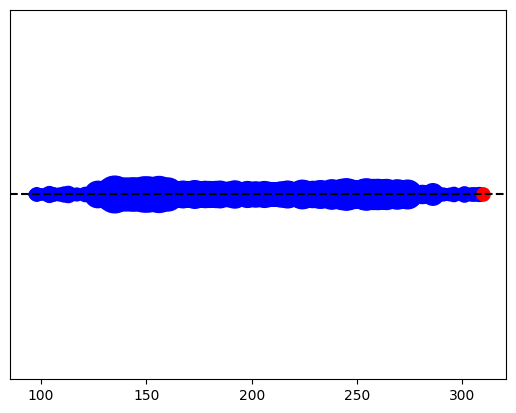

In [93]:
#Revisamos posibles Outliers de average_montly_hours
sizes = counts*5
colors = ['blue']*len(montly_hours_unique)
colors[-1] = 'red'

plt.axhline(1, color='k', linestyle='--')
plt.scatter(montly_hours_unique, np.ones(len(montly_hours_unique)), s=sizes, color=colors)
plt.yticks([])
plt.show()

Vemos en la gráfica que solo se presentan unos pocos outliers en el extremo derecho, donde los valores cantidad mensuales de horas está por sobre los 300.

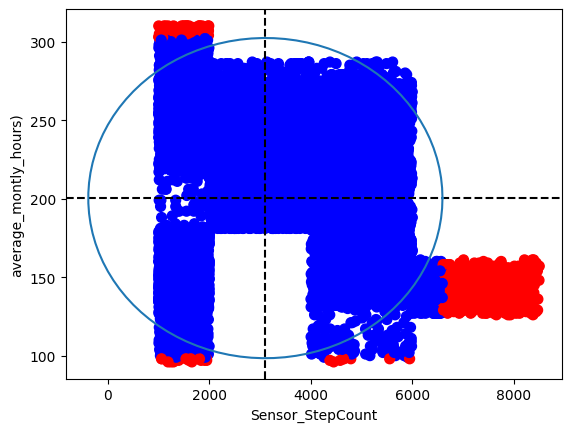

In [94]:
from math import pi

media = (ds4.average_montly_hours).mean()
std_x = (ds4.average_montly_hours).std()*2
media_y = (ds4.Sensor_StepCount).mean()
std_y = (ds4.Sensor_StepCount).std()*2

colors = ['blue']*len(ds4.average_montly_hours)
for index, x in enumerate(ds4.average_montly_hours):
    if abs(x-media) > std_x:
        colors[index] = 'red'

for index, x in enumerate(ds4.Sensor_StepCount):
    if abs(x-media_y) > std_y:
        colors[index] = 'red'

plt.scatter(ds4.Sensor_StepCount, ds4.average_montly_hours, s=50, color=colors)
plt.axhline(media, color='k', linestyle='--')
plt.axvline(media_y, color='k', linestyle='--')

v=media     #y-position of the center
u=media_y    #x-position of the center
b=std_x     #radius on the y-axis
a=std_y    #radius on the x-axis

t = np.linspace(0, 2*pi, 100)
plt.plot( u+a*np.cos(t) , v+b*np.sin(t) )

plt.xlabel('Sensor_StepCount')
plt.ylabel('average_montly_hours)')
plt.show()

Analizando en forma bidimensional, con las dimensiones que clusterizamos (promedio de horas mensuales y cantidad de pasos según sensor) detectamos outliers sobretodo en el Cluster N° 3.

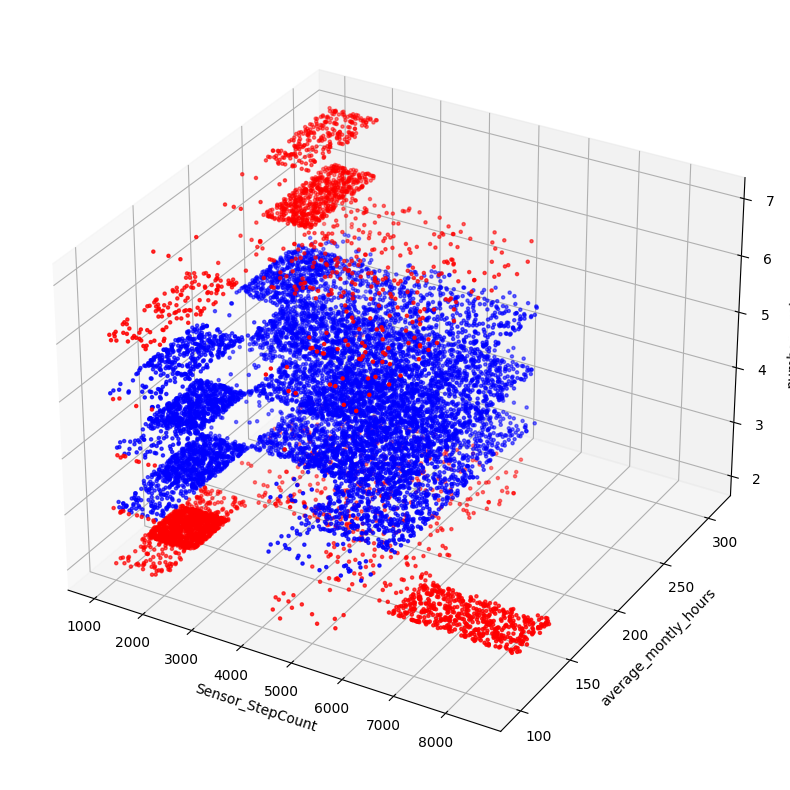

In [95]:
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(projection = '3d')

#Sensor_StepCount = ds4.number_project
media_z = (ds4.number_project).mean()
std_z = (ds4.number_project).std()*1

for index, x in enumerate(ds4.number_project):
    if abs(x-media_z) > std_z:
        colors[index] = 'red'

ax.scatter((ds4.Sensor_StepCount), (ds4.average_montly_hours), (ds4.number_project), s=5, c=colors)
plt.xlabel('Sensor_StepCount')
plt.ylabel('average_montly_hours')
ax.set_zlabel('number_project')

plt.show()

Analizando con tres dimensiones vemos que los outliers se detectan en similares zonas a los mostrados en el análisis bidemnsional, a excepcion de unas pocas capas determinadas por los valores de números de proyectos.

### Isolation Forest

In [96]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error

In [97]:
# evaluar predicciones
mae = mean_absolute_error(y_test, y_pred)
print('MAE: %.3f' % mae)

MAE: 0.726


In [98]:
from sklearn.ensemble import IsolationForest

data = ds4.values
X, y = data[:, :-1], data[:, -1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=0)
print(X_train.shape, y_train.shape)


# identificar outliers en el dataset de train
iso = IsolationForest(contamination=0.1) # contamination = proporcion de outliers esperada
yhat = iso.fit_predict(X_train)
mask = yhat != -1 # filtro

(9884, 15) (9884,)


In [99]:
# seleccionar todas las filas que no son outliers
X_train, y_train = X_train[mask, :], y_train[mask]

# Ajustar modelo
model = LinearRegression()
model.fit(X_train, y_train)
# evaluar el modelo
yhat = model.predict(X_test)
# evaluar predicciones
mae = mean_absolute_error(y_test, yhat)
print('MAE: %.3f' % mae)

MAE: 0.709


Con Isolation Forest no mejoran los resultados, pasan de 0.726 a 0.713


### Minimum Covariance Determinant

In [100]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.covariance import EllipticEnvelope
from sklearn.metrics import mean_absolute_error

data = ds4.values
X, y = data[:, :-1], data[:, -1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=0)
print(X_train.shape, y_train.shape)
# identicar outliers con el metodo
ee = EllipticEnvelope(contamination=0.01)
yhat = ee.fit_predict(X_train)
# Seleccionar filas que no son outliers
mask = yhat != -1
X_train, y_train = X_train[mask, :], y_train[mask]
# Dataset reusltante luego de limpiar
print(X_train.shape, y_train.shape)
# Ajustar el modelo
model = LinearRegression()
model.fit(X_train, y_train)
# Obtener predicciones
yhat = model.predict(X_test)
# evaluar predicciones
mae = mean_absolute_error(y_test, yhat)
print('MAE: %.3f' % mae)

(9884, 15) (9884,)
(9785, 15) (9785,)
MAE: 0.727


Con Minimum Covariance Determinant los resultados mejoran ínfimamente, pasan de 0.726 a 0.727

### Local Outlier Factor

In [101]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import LocalOutlierFactor
from sklearn.metrics import mean_absolute_error


data = ds4.values
X, y = data[:, :-1], data[:, -1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=0)
print(X_train.shape, y_train.shape)
# identicar outliers en train
lof = LocalOutlierFactor()
yhat = lof.fit_predict(X_train)
# seleccionar filas que no son outliers
mask = yhat != -1
X_train, y_train = X_train[mask, :], y_train[mask]
# dataset resultante luego del filtro
print(X_train.shape, y_train.shape)
# ajustar el modelo
model = LinearRegression()
model.fit(X_train, y_train)
# evaluar el modelo
yhat = model.predict(X_test)
# evaluar predicciones
mae = mean_absolute_error(y_test, yhat)
print('MAE: %.3f' % mae)

(9884, 15) (9884,)
(9852, 15) (9852,)
MAE: 0.726


Con Local Outlier Factor los resultados se mantienen similares en 0.726

### One-Class SVM

In [102]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.svm import OneClassSVM
from sklearn.metrics import mean_absolute_error

data = ds4.values
X, y = data[:, :-1], data[:, -1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=0)
print(X_train.shape, y_train.shape)
# identicar outliers en train
ee = OneClassSVM(nu=0.01)
yhat = ee.fit_predict(X_train)
# Seleccionar filas que no son outliers
mask = yhat != -1
X_train, y_train = X_train[mask, :], y_train[mask]
# dataset resultante tamaño
print(X_train.shape, y_train.shape)
# Ajustar el modelo
model = LinearRegression()
model.fit(X_train, y_train)
# evaluar el modelo
yhat = model.predict(X_test)
# evaluar predicciones
mae = mean_absolute_error(y_test, yhat)
print('MAE: %.3f' % mae)

(9884, 15) (9884,)
(9782, 15) (9782,)
MAE: 0.720


Con One-Class SVM los resultados tampoco mejoran, pasan de 0.726 a 0.720

Con Minimum Covariance Determinant encontramos la mejor performance, 0.727

Con este análisis estamos en condiciones de sugerir analizar las variables consideradas, en los casos que querramos evitar su futura renuncia.


## Variables Sintéticas

In [103]:
ds4['rc_sensor_hart'] = np.sqrt(ds4['Sensor_Heartbeat(Average/Min)'])
ds4['log_sensor_SC'] = np.log(ds4['Sensor_StepCount'])

In [104]:
ds4.head()

,number_project,promotion_last_5years,Emp_Identity,Critical,EMP_Sat_On_P,EMP_Sat_Rem_P,Emp_Collaborative,Emp_Competitive,Work_accident,Sensor_StepCount,Sensor_Heartbeat(Average/Min),time_spend_company,average_montly_hours,last_evaluation,pred,EMP_Engag_Prom,rc_sensor_hart,log_sensor_SC
0,3,0,1,1.0,3.6,2.4,2.4,2.4,1,1841,61,3,168,0.36,1,4.2,7.810250,7.518064
1,4,0,2,0.0,3.6,2.4,2.4,2.0,1,3248,77,4,278,0.36,3,4.2,8.774964,8.085795
2,3,0,2,0.0,3.6,2.4,3.0,2.8,0,1974,64,3,114,0.36,1,4.2,8.000000,7.587817
3,4,0,1,1.0,3.6,2.4,3.2,2.8,0,2121,80,3,242,0.36,6,4.2,8.944272,7.659643
4,5,0,1,1.0,3.6,2.4,2.8,2.8,1,3056,76,6,269,0.36,3,4.2,8.717798,8.024862


## PCA

In [105]:
# Preparación de datos
X = ds4[['number_project', 'promotion_last_5years' , 'Emp_Identity', 'Critical', 'Work_accident' ,'time_spend_company' ,'average_montly_hours' ,'last_evaluation' ,'pred']]
y = ds4['EMP_Engag_Prom']

In [106]:
# Separacion en train y test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [107]:
# Normalizamos los datos para PCA
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [108]:
# Aplicacion de PCA
from sklearn.decomposition import PCA

pca = PCA()
X_train = pca.fit_transform(X_train)
X_test = pca.transform(X_test)

In [109]:
#Análisis de la varianza explicada para cada componente
explained_variance = pca.explained_variance_ratio_
explained_variance

array([0.22868302, 0.15477693, 0.11788749, 0.11391255, 0.10734042,
       0.09553447, 0.08445098, 0.05764083, 0.03977331])

Insights:

El primer componente principal es responsable de la varianza del 22%. De manera similar, el segundo componente principal causa una variación del 15% en el conjunto de datos. En conjunto, podemos decir que (22 + 15 ) el 38% por ciento de la información de clasificación contenida en el conjunto de características es capturada por los dos primeros componentes principales.

Para finalizar, usemos una sola componente para entrenar un modelo de Random Forest y evaluar como funciona.


In [110]:
from sklearn.decomposition import PCA

pca = PCA(n_components=1)
X_train = pca.fit_transform(X_train)
X_test = pca.transform(X_test)

In [111]:
from sklearn.ensemble import RandomForestClassifier

#Entrenamiento del modelo
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)

LinearRegression()

In [112]:
regressor.coef_

array([-0.00942945])

In [113]:
regressor.intercept_

3.5320113314447594

In [114]:
X.columns

Index(['number_project', 'promotion_last_5years', 'Emp_Identity', 'Critical',
       'Work_accident', 'time_spend_company', 'average_montly_hours',
       'last_evaluation', 'pred'],
      dtype='object')

In [115]:
#Realizando las predicciones
y_pred = regressor.predict(X_test)
y_pred

array([3.51744626, 3.52074132, 3.55059194, ..., 3.52353901, 3.52431778,
       3.52813688])

In [116]:
y_test

4003     4.2
11396    1.8
5013     4.2
6788     4.2
10641    4.2
        ... 
1294     4.2
1741     1.8
8851     4.2
8469     4.2
8681     4.2
Name: EMP_Engag_Prom, Length: 2471, dtype: float64

In [117]:
y_pred

array([3.51744626, 3.52074132, 3.55059194, ..., 3.52353901, 3.52431778,
       3.52813688])

In [118]:
ds3 = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
ds3['Sesgo']=ds3.Actual -ds3.Predicted
ds3['Error_porc']=((ds3.Actual -ds3.Predicted)/ds3.Actual) *100
ds3

,Actual,Predicted,Sesgo,Error_porc
4003,4.2,3.517446,0.682554,16.251279
11396,1.8,3.520741,-1.720741,-95.596740
5013,4.2,3.550592,0.649408,15.462097
6788,4.2,3.538739,0.661261,15.744316
10641,4.2,3.522501,0.677499,16.130938
...,...,...,...,...
1294,4.2,3.540834,0.659166,15.694419
1741,1.8,3.551925,-1.751925,-97.329178
8851,4.2,3.523539,0.676461,16.106214
8469,4.2,3.524318,0.675682,16.087672


## EVALUACION MODELO

In [119]:
def mse(actual, predicted):
    return np.mean(np.square(actual-predicted))

In [120]:
def mape(actual, predicted):
    return np.mean(np.abs((actual - predicted) / actual)) * 100

In [121]:
mape(y_test, y_pred)

39.97998121145075

In [122]:
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred)) # MAE
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred)) # MSE
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred))) # RMSE

Mean Absolute Error: 0.9865230918667925
Mean Squared Error: 1.2105951990064419
Root Mean Squared Error: 1.1002705117408362


In [123]:
from sklearn.metrics import r2_score
print('El r^2 es:',r2_score(y_test,y_pred))

El r^2 es: -0.0002833872361531764


Como se desprende del r^2 el modelo no es un buen predictor del engagement.

## LOOCV


In [124]:
# librerias
from numpy import mean
from numpy import std
from sklearn.model_selection import LeaveOneOut
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier

In [125]:
# crear el procediemiento LOOCV
cv = LeaveOneOut()

In [126]:
# crear el modelo
from sklearn.ensemble import RandomForestRegressor
model = RandomForestRegressor(random_state=0, n_estimators=10,max_depth=4)

In [127]:
cross_val_score

<function sklearn.model_selection._validation.cross_val_score(estimator, X, y=None, *, groups=None, scoring=None, cv=None, n_jobs=None, verbose=0, fit_params=None, pre_dispatch='2*n_jobs', error_score=nan)>

In [128]:
# evaluar el modelo (criterio de comparacion MAE)
from sklearn.metrics import mean_squared_error,  make_scorer, mean_absolute_error
MAE = make_scorer(mean_absolute_error)
scores = cross_val_score(model, X, y, scoring=MAE, cv=cv,error_score='raise',verbose=1)
# convertir a postivos
scores = abs(scores)
# reportar el performance
print('MAE: %.3f (%.3f)' % (mean(scores), std(scores)))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


MAE: 0.186 (0.426)


[Parallel(n_jobs=1)]: Done 12355 out of 12355 | elapsed: 20.6min finished


El modelo se evalúa usando LOOCV y el desempeño del modelo al hacer predicciones sobre nuevos datos tiene un MAE de ~0.186 en valores que van de 0 a 5, es decir representa un 3.7%.


# Variables que apalancan el Compromiso


Finalmente evaluar un econding previo con el objetivo de determinar que variables pueden ser predictoras del compromiso (EMP_Eng_Prom).


In [129]:
#Genereamos un nuevo dataset solo con los features que nos interesan
ds5 = ds1_num[['number_project', 'Emp_Identity', 'EMP_Sat_On_P' ,  'Sensor_StepCount' , 'time_spend_company' ,'average_montly_hours' ,'last_evaluation' ,'EMP_Engag_Prom']].copy()

In [131]:
ds5.EMP_Engag_Prom = ds5.EMP_Engag_Prom.replace({1.8 : 0, 4.2 : 1})
ds5["EMP_Engag_Prom"] = ds5["EMP_Engag_Prom"].astype(int)
#ds5["Critical"] = ds5["Critical"].astype(int)

In [132]:
ds5


,number_project,Emp_Identity,EMP_Sat_On_P,Sensor_StepCount,time_spend_company,average_montly_hours,last_evaluation,EMP_Engag_Prom
0,3,1,3.6,1841,3,168,0.36,1
1,4,2,3.6,3248,4,278,0.36,1
2,3,2,3.6,1974,3,114,0.36,1
3,4,1,3.6,2121,3,242,0.36,1
4,5,1,3.6,3056,6,269,0.36,1
...,...,...,...,...,...,...,...,...
12398,5,3,3.4,4251,5,204,1.00,1
12399,6,3,3.4,5646,2,206,1.00,1
12400,3,4,3.4,5910,6,231,1.00,1
12401,4,4,3.4,4386,3,145,1.00,1


In [133]:
# Generamos features y target
X = ds5.drop('EMP_Engag_Prom', axis=1)
y = ds5['EMP_Engag_Prom']

In [134]:
# Train test split
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2,
                                                    random_state=0,
                                                    stratify= y)


print('Tamaño del set de Entrenamiento:', X_train.shape)
print('Tamaño del set de Testeo:', X_test.shape)

Tamaño del set de Entrenamiento: (9884, 7)
Tamaño del set de Testeo: (2471, 7)


In [135]:
100*y_train.sum()/len(y_train) # Porcentaje de True en train

71.7320922703359

In [136]:
100*y_test.sum()/len(y_test) # Porcentaje de True en test

71.7118575475516

In [137]:
100*y_test.sum()/len(y_test) # Porcentaje de True en test

71.7118575475516

In [138]:
# Instanciar el objeto/modelo
tree_model = DecisionTreeClassifier(random_state = 0, class_weight='balanced')

In [139]:
# Ajustar el modelo con los datos
tree_model.fit(X_train, y_train)

DecisionTreeClassifier(class_weight='balanced', random_state=0)

In [140]:
# Graficamos el Arbol
from sklearn import tree
fig = plt.figure(figsize=(200,200))
_ = tree.plot_tree(tree_model,feature_names = list(ds5),class_names=['No Comprometido','Comprometido'],

                   filled=True)

In [141]:
# predicciones
y_pred = tree_model.predict(X_test)
y_pred_train = tree_model.predict(X_train)

In [142]:
X_test.shape, y_test.shape

((2471, 7), (2471,))

In [143]:
y_pred.shape

(2471,)

In [144]:
X_test

,number_project,Emp_Identity,EMP_Sat_On_P,Sensor_StepCount,time_spend_company,average_montly_hours,last_evaluation
370,2,1,3.6,6998,3,135,0.47
1460,4,1,3.6,3151,3,244,0.54
5297,4,1,3.6,1729,2,176,0.47
10543,5,1,3.4,1224,4,303,0.87
5606,4,1,3.6,3575,3,275,0.49
...,...,...,...,...,...,...,...
10784,3,4,3.4,4617,2,189,0.88
10595,5,3,3.4,5987,4,156,0.87
4356,7,2,3.4,1329,4,273,0.92
7016,2,1,3.6,7640,3,142,0.57


In [145]:
y_pred[:10]

array([0, 1, 1, 0, 1, 0, 0, 1, 1, 1])

In [146]:
y_test[:10].values

array([0, 1, 1, 0, 1, 0, 0, 1, 1, 1])

In [147]:
# Evaluacion
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

In [148]:
# Evaluamos el modelo en el conjunto de testeo:
recall = recall_score(y_train, y_pred_train)
precision = precision_score(y_train, y_pred_train)
acc = accuracy_score(y_train, y_pred_train)
f1 = f1_score(y_train, y_pred_train)

print('METRICAS TRAIN:')
print('Recall: {:.4f}'.format(recall))
print('Precision: {:.4f}'.format(precision))
print('F1: {:.4f}'.format(f1))
print('Accuracy: {:.4f}'.format(acc))

METRICAS TRAIN:
Recall: 1.0000
Precision: 1.0000
F1: 1.0000
Accuracy: 1.0000


In [150]:
# Evaluamos el modelo ya entrenado en el conjunto de testeo
recall = recall_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
acc = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

print('METRICAS TEST:')
print('Recall: {:.4f}'.format(recall))
print('Precision: {:.4f}'.format(precision))
print('F1: {:.4f}'.format(f1))
print('Accuracy: {:.4f}'.format(acc))

METRICAS TEST:
Recall: 0.9915
Precision: 0.9938
F1: 0.9927
Accuracy: 0.9895


Los resultados son muy buenos, el modelo es un buen predictor del Compromiso.

In [151]:
confusion_matrix(y_test, y_pred)

array([[ 688,   11],
       [  15, 1757]])

In [152]:
y_test.value_counts()

1    1772
0     699
Name: EMP_Engag_Prom, dtype: int64

In [153]:
type(y_pred)

numpy.ndarray

In [154]:
pd.Series(y_pred).value_counts()

1    1768
0     703
dtype: int64

In [155]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98       699
           1       0.99      0.99      0.99      1772

    accuracy                           0.99      2471
   macro avg       0.99      0.99      0.99      2471
weighted avg       0.99      0.99      0.99      2471



In [156]:
proba = tree_model.predict_proba(X_test)
proba

array([[1., 0.],
       [0., 1.],
       [0., 1.],
       ...,
       [1., 0.],
       [1., 0.],
       [0., 1.]])

In [157]:
df_importancia = pd.DataFrame({'Variable': X_train.columns.values.tolist(),
                               'Importancia': tree_model.feature_importances_}).sort_values(by='Importancia', ascending=False)

df_importancia

,Variable,Importancia
3,Sensor_StepCount,0.612271
0,number_project,0.181051
5,average_montly_hours,0.154335
6,last_evaluation,0.036090
4,time_spend_company,0.007670
2,EMP_Sat_On_P,0.007080
1,Emp_Identity,0.001502


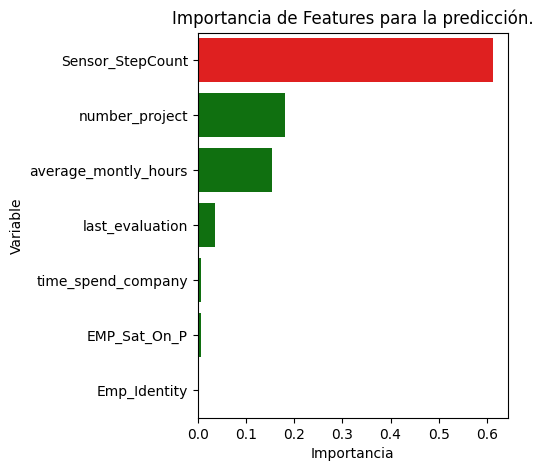

In [158]:
plt.figure(figsize=(4,5))

values = df_importancia.Importancia

sns.barplot(y=df_importancia.Variable,
            x=values,
            palette = ['green' if (x < max(values)) else 'red' for x in values ]
           ).set(title='Importancia de Features para la predicción.')

plt.show()

Random Forest


In [159]:
from sklearn.ensemble import RandomForestClassifier
clf = RandomForestClassifier(max_depth=2, random_state=0, n_estimators = 200)
clf.fit(X, y)
y_pred= clf.predict(X_test)

In [160]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.9708619991906111


In [161]:
ds6 = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
ds6['Sesgo']=ds6.Actual -ds6.Predicted
ds6

,Actual,Predicted,Sesgo
370,0,0,0
1460,1,1,0
5297,1,1,0
10543,0,0,0
5606,1,1,0
...,...,...,...
10784,1,1,0
10595,1,1,0
4356,0,0,0
7016,0,0,0


In [162]:
### métrica Accuracy.
from sklearn.metrics import accuracy_score
accuracy_score(y_test,y_pred)

0.9708619991906111

In [163]:
###Precision
from sklearn.metrics import precision_score
precision_score(y_test, y_pred)

0.9711751662971175

In [164]:
###Recall
from sklearn.metrics import recall_score
recall_score(y_test, y_pred)

0.9887133182844243

In [165]:
### F1 score
from sklearn.metrics import f1_score
f1_score(y_test, y_pred)

0.9798657718120806

Con Random Forest tambien logramos un muy buen predictor del Compromiso.

# COMENTARIOS FINALES (TECNICOS)

Encontramos un modelo que es muy efectivo para para predecir o identificar a los renunciantes con el dataset en cuestión aplicando el Arbol de decisión.

Debido a que la predicción está atada a la variable relacionada con el Engagement o Compromiso.

Luego se aplicaron distintos procedimientos en busqueda de generar un perfil de renunciante; por medio del cual poder entender que variables pueden ser buenas predictoras del Compromiso.

Asi finalmente aplicamos Arbol de Decisión y Random Forest sobre las variables y encontramos que los modelos son muy buenos predictores del Compromiso; las variables de mayor importancia son : Sensor_StepCount, number_project, average_montly_hours, last_evaluation, EMP_Sat_On_P, time_spend_company y Emp_Identity.

Se debe destacar que el Dataset trabajado fue extraido de Kagle, y en la información relacionada se aclara que parte de los datos son ficcticios; esto puede explicar la linealidad del 100% entre Renuncias y Compromiso; si bien se espera una alta correlación jamas encontraríamos un valor tan alto, muchos menos del 100%.

# COMENTARIOS FINALES (INSIGHT)

Interpretando el trabajo, detectamos que el nivel de compromiso es el mejor predictor de las renuncias.

Para interpretar el perfil renunciante se deben considerar las variables: Sensor_StepCount, number_project, average_montly_hours, last_evaluation, EMP_Sat_On_P, time_spend_company y Emp_Identity.

Ahora bien, a fin de generar cambios en los niveles de renuncia se pueden generar cambios en number_project, average_montly_hours, last_evaluation; variables que dependen de la empresa.

Por otro lado la variable Sensor_StepCount, EMP_Sat_On_P y Emp_Identity son variables comportamentales propias del colaborador sobre las que no se puede accionar facilmente, pero si pueden ser tenidas en cuenta para identficar posibles renunciantes y anticiparse con planes de reemplazo por ejemplo.


Traduciendo los datos a posibles acciones, estamos en condiciones de sugerir:

 * Accionar sólo sobre la población con mayor probabilidad de renuncia según el modelo, aprox. el 23%
 * Modificar la cantidad de proyectos, las cantidad de horas trabajadas (variable con mayor impacto en el engagement).

El costo de esta acción sería de bajo costo, debido a que solo se debería accionar sobre la población afectada del 23 % aproximádamente, y sobre variables que en algunos casos no representan costos adicionales.

Es esprable un alto impacto debido a que las acciones reducen la renuncia y el ahorro de sus costos asociados.
